# (2) SHIFT CV WINTER 2023 - Blurred Image Detection via Supervised Learning using Dataset split

### Project Description
There is a dataset of images, par of which is blurred. The task is to develop a machine learning algorithm to detect whether the image is blurred or sharp on the unknown dataset.

### Data Description
The dataset consists of images, and some of them are blurred. The images are blurred using augmentation.

Data files:
- ```train``` - a folder for training
- ```test``` - a folder with images, for which we make predicitons
- ```train.csv``` - labels (answers) to the train sample: **if 1, the image is blurred.**

### Papers:
- Fourier transformation https://homepages.inf.ed.ac.uk/rbf/HIPR2/fourier.htm
- https://jiaya.me/all_final_papers/blur_detect_cvpr08.pdf
- https://fled.github.io/paper/blur.pdf
- http://graphics.im.ntu.edu.tw/docs/mmm08.pdf

In [6]:
pip install -qqq ipyplot

Note: you may need to restart the kernel to use updated packages.


In [7]:
pip install -q jupyter_contrib_nbextensions

Note: you may need to restart the kernel to use updated packages.


In [8]:
import os
import tensorflow as tf
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
plt.style.use('dark_background')
import seaborn as sns
import ssl
import torch
import glob

from ipyplot import plot_images
from pylab import *
from PIL import Image
from sklearn.utils import shuffle
from keras.models import Sequential
from tqdm.keras import TqdmCallback
from keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout, BatchNormalization, Activation
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn.metrics import accuracy_score
from sklearn.preprocessing import OneHotEncoder
from keras import regularizers, optimizers
from sklearn.metrics import classification_report, confusion_matrix
from tensorflow.keras import layers
from tensorflow.keras import optimizers
from tensorflow import keras
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications.resnet import ResNet50
from tensorflow.keras.layers import GlobalAveragePooling2D, Dense
from tensorflow.keras.models import Sequential
from tensorflow.keras.optimizers import Adam
from tqdm import tqdm

import warnings
warnings.simplefilter("ignore")

## 1 Data load

In [26]:
from PIL import Image, ImageFilter

In [29]:
img = '/Users/yuliabezginova/PycharmProjects/00_files-for_NLP/shift-cv-winter-2023/train/train/aaashhimmhraddpwwizz.jpg'
with Image.open(img) as img:
    img.load()

In [30]:
blur_img = img.filter(ImageFilter.BLUR)
blur_img.show()

In [31]:
img.filter(ImageFilter.BoxBlur(5)).show()
img.filter(ImageFilter.BoxBlur(20)).show()
img.filter(ImageFilter.GaussianBlur(20)).show()

In [32]:
sharp_img = img.filter(ImageFilter.SHARPEN)
img.crop((300, 300, 500, 500)).show()
sharp_img.crop((300, 300, 500, 500)).show()

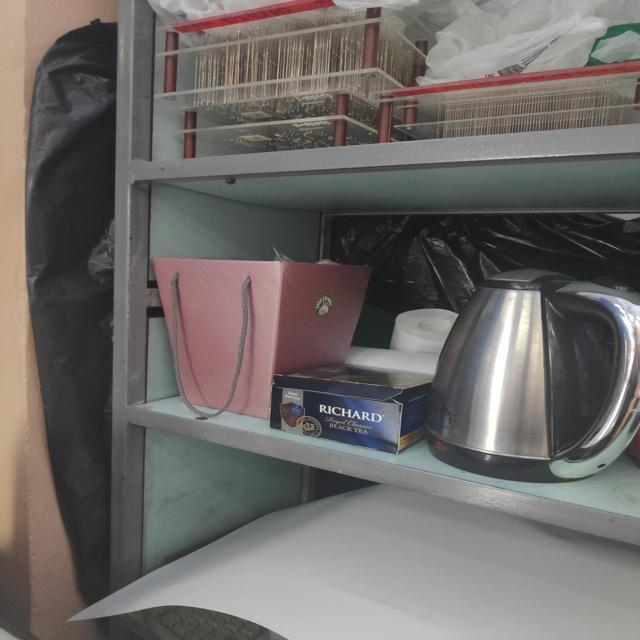

In [28]:
img = Image.open('/Users/yuliabezginova/PycharmProjects/00_files-for_NLP/shift-cv-winter-2023/train/train/aaashhimmhraddpwwizz.jpg')
img

In [9]:
df_train = pd.read_csv('/Users/yuliabezginova/PycharmProjects/00_files-for_NLP/shift-cv-winter-2023/train.csv')
print(len(df_train))

2664


In [10]:
path = '/Users/yuliabezginova/PycharmProjects/00_files-for_NLP/shift-cv-winter-2023/train/train/'

df_train['filename'] = df_train['filename'].apply(lambda x: path + x)
df_train.head()

,filename,blur
0,/Users/yuliabezginova/PycharmProjects/00_files...,0.0
1,/Users/yuliabezginova/PycharmProjects/00_files...,0.0
2,/Users/yuliabezginova/PycharmProjects/00_files...,0.0
3,/Users/yuliabezginova/PycharmProjects/00_files...,0.0
4,/Users/yuliabezginova/PycharmProjects/00_files...,1.0


In [11]:
test_imgs = []
for file in glob.glob("/Users/yuliabezginova/PycharmProjects/00_files-for_NLP/shift-cv-winter-2023/test/test/*.jpg"):
    test_imgs.append({'filename': file})
df_test = pd.DataFrame(test_imgs)
print("Test images: ", len(df_test))

Test images:  774


In [12]:
train_blur = df_train[df_train["blur"]==1]
train_sharp = df_train[df_train["blur"]==0]

print("blur images:", len(train_blur))
print("sharp images:", len(train_sharp))

blur images: 1297
sharp images: 1367


## ***Examples of sharp images***


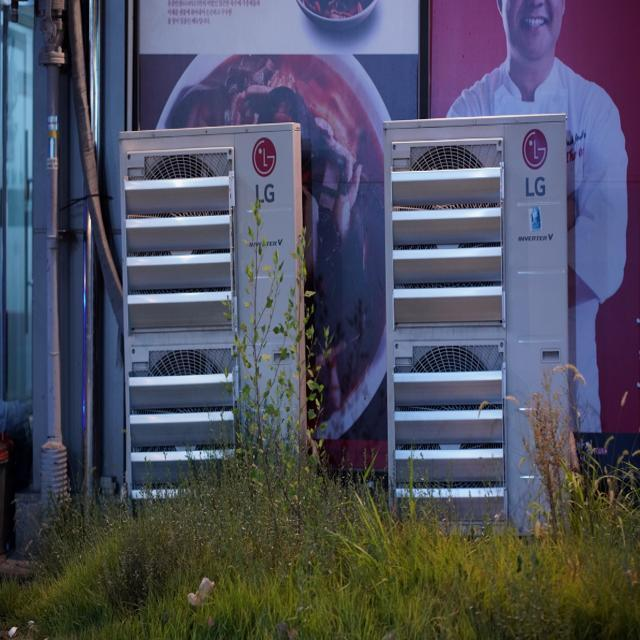
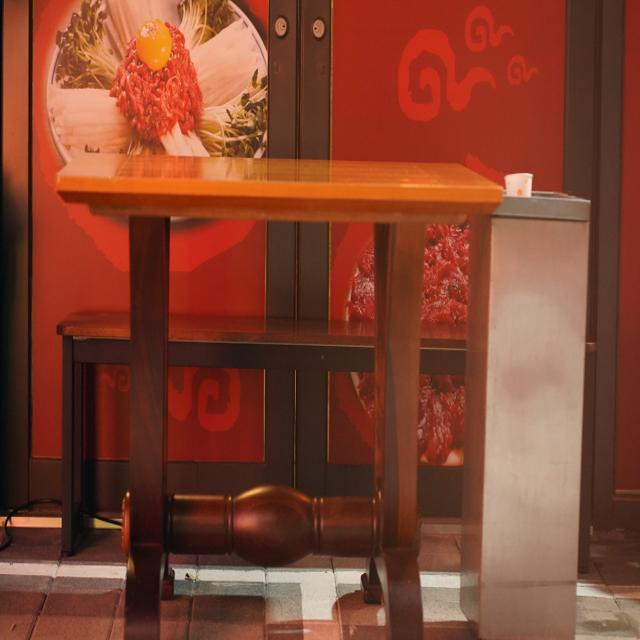
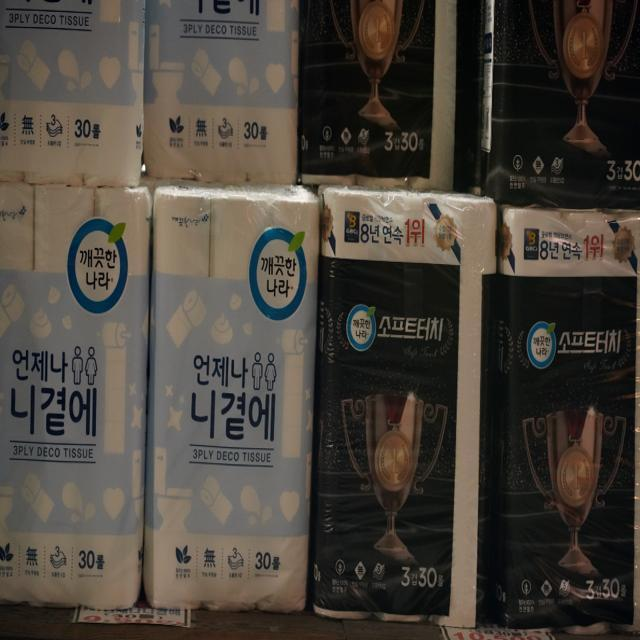
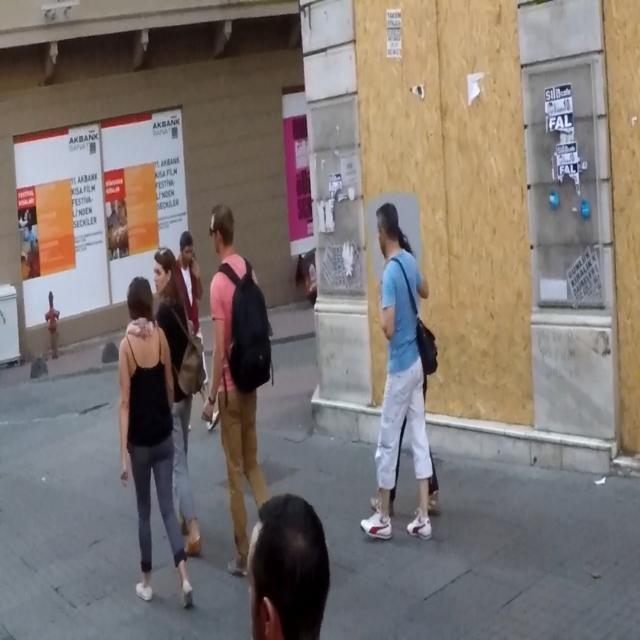
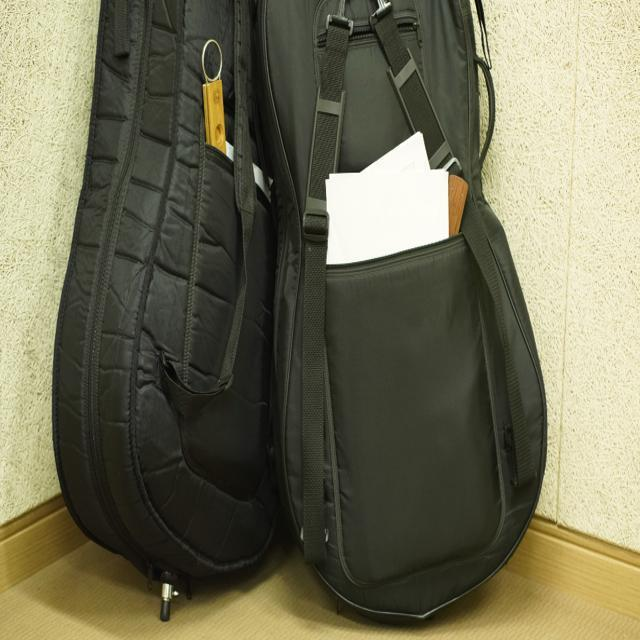
...
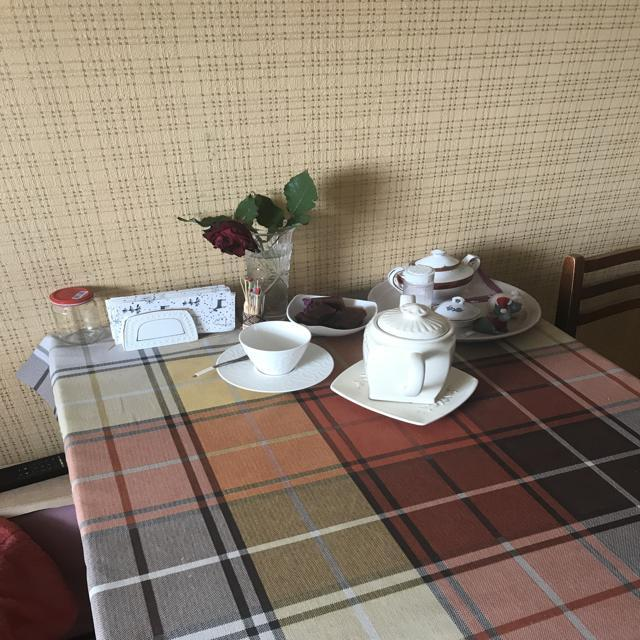
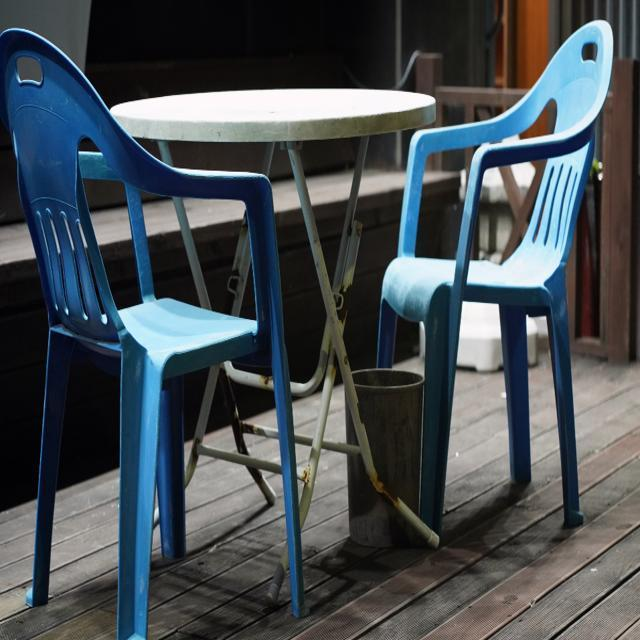
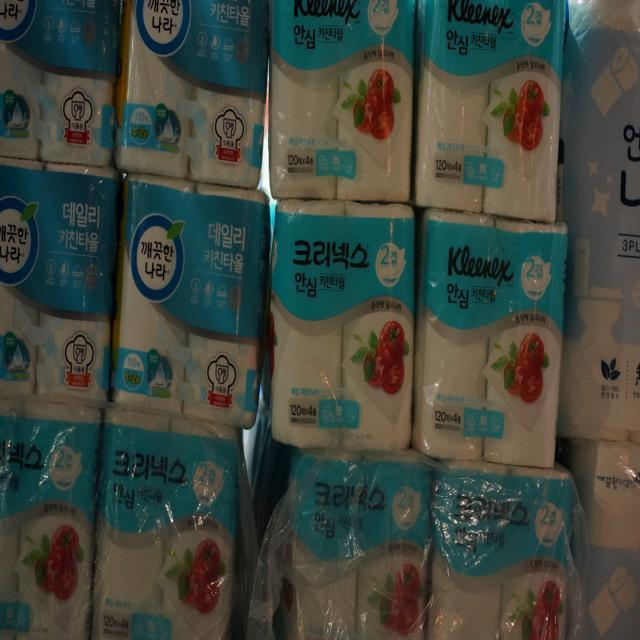
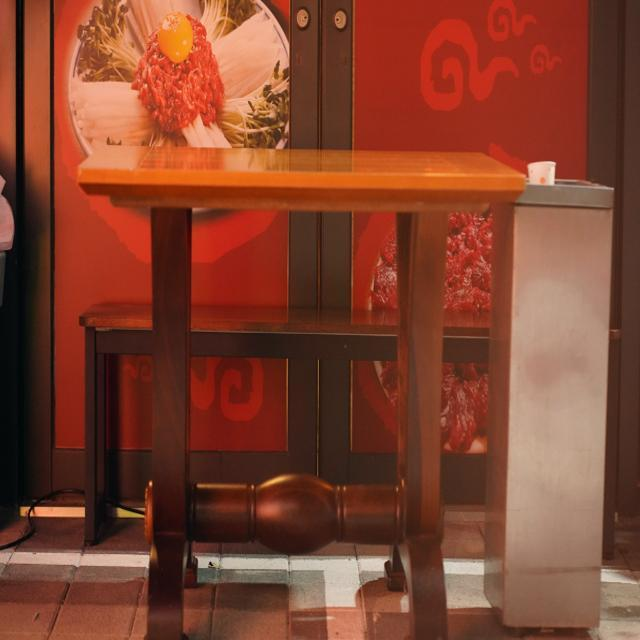
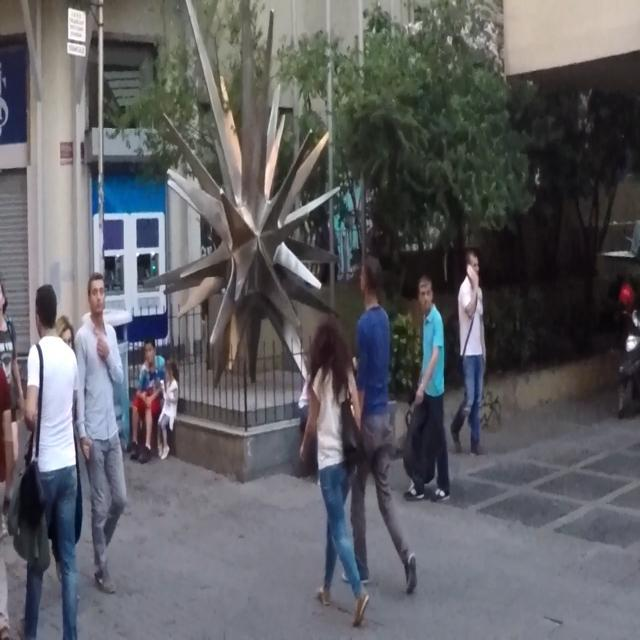

In [13]:
images = train_sharp.filename.sample(10).tolist()
plot_images(images, 
            max_images=10,
            img_width=220,
            force_b64=True)

## ***Examples of blurred images***


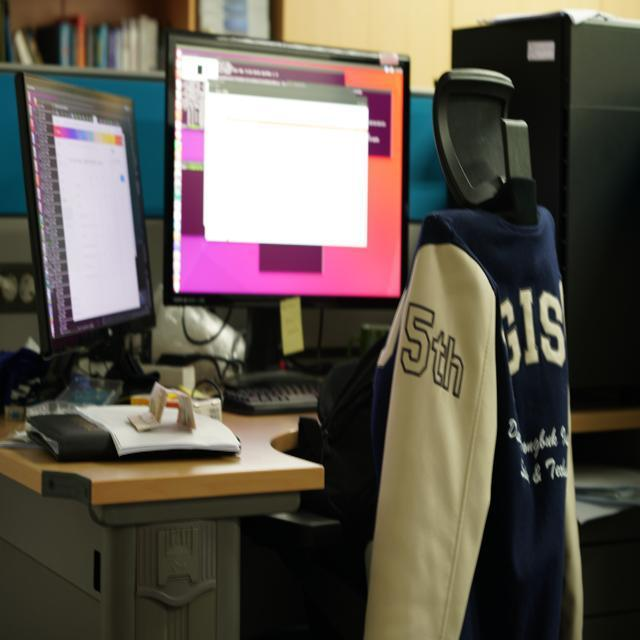
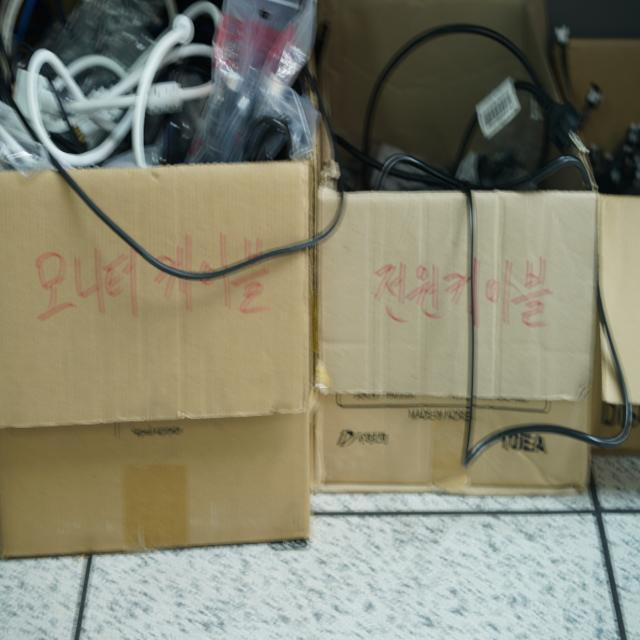
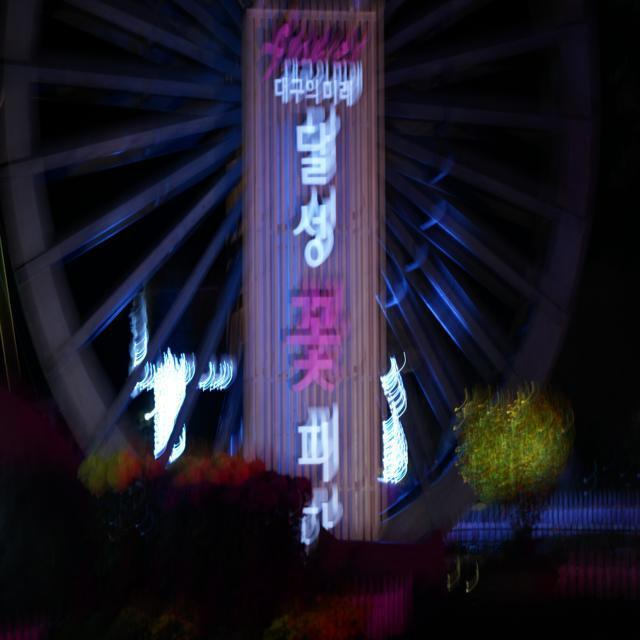
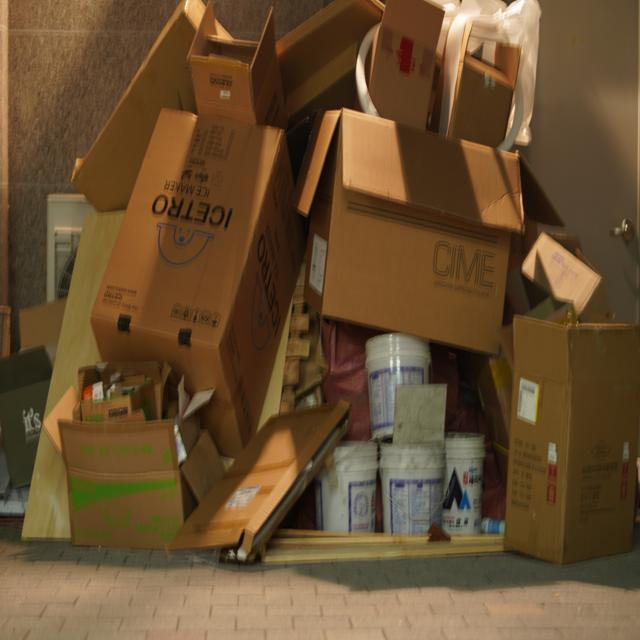
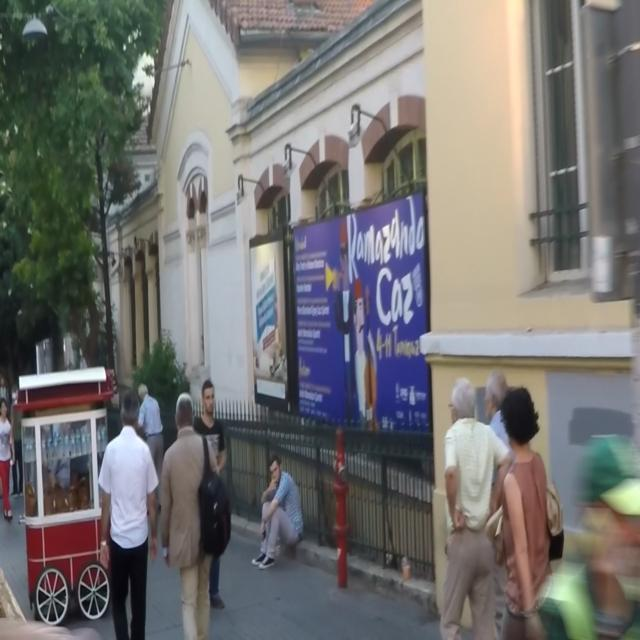
...
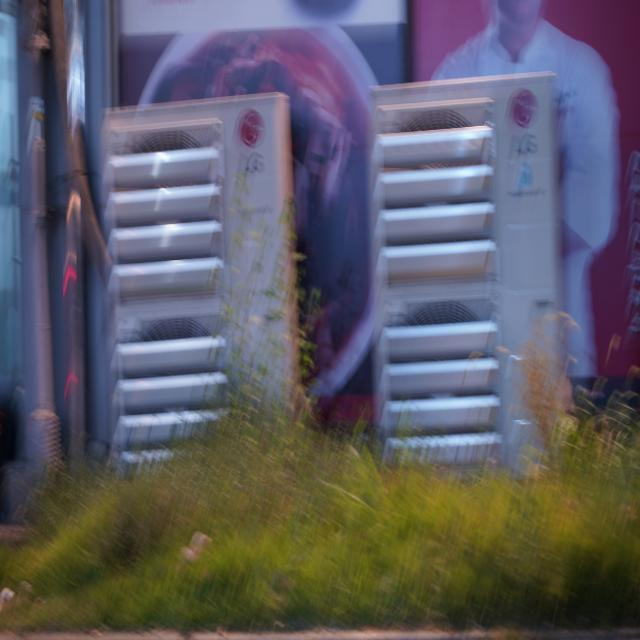
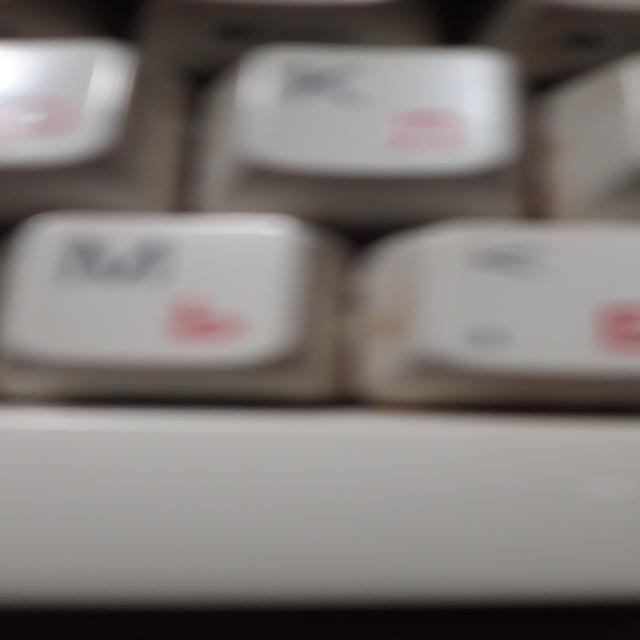
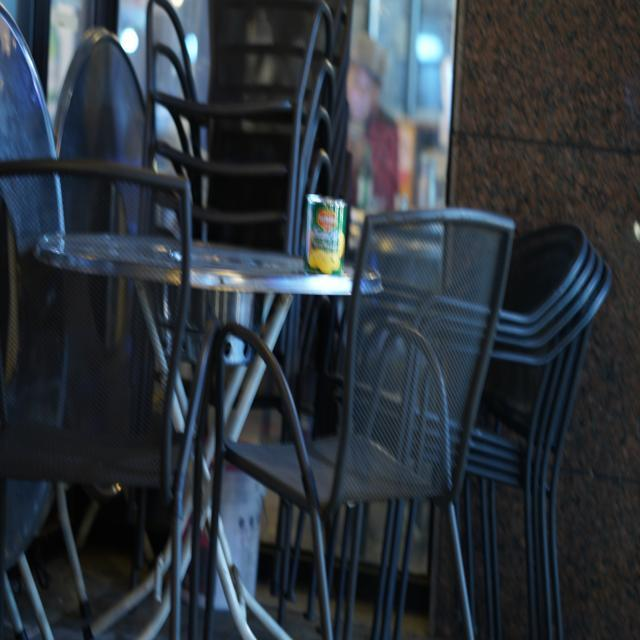
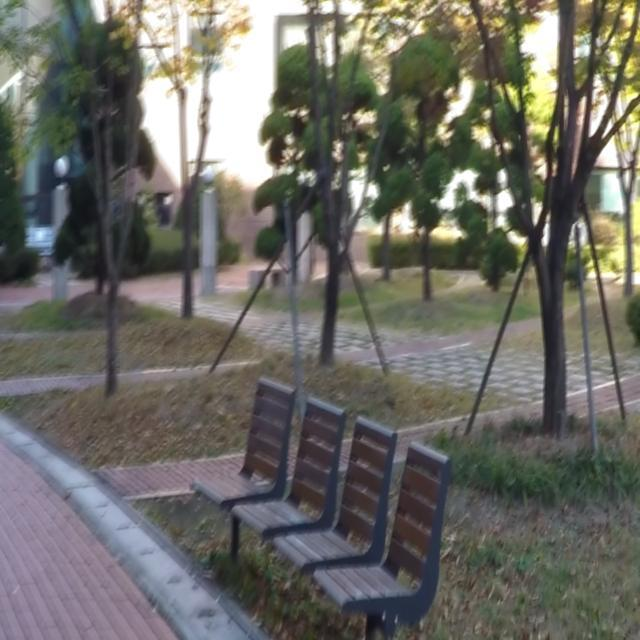
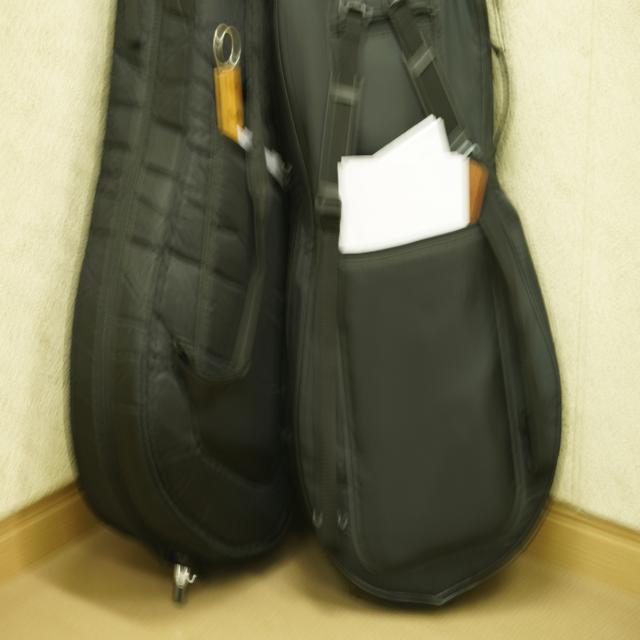

In [14]:
images = train_blur.filename.sample(10).tolist()
plot_images(images,
            max_images=10,
            img_width=220,
            force_b64=True)

## 2 Creating custom dataset and dataloader

In [30]:
def read_image_gray(path):
    return cv2.cvtColor(cv2.imread(path), cv2.COLOR_BGR2GRAY)

In [23]:
class CustomDataset(Dataset):
    def __init__(self, df):
        self.df = df
               
    def __len__(self):
        return len(self.df)


class CustomDatasetTrain(CustomDataset):
    def __init__(self, df, transform=None):
        super().__init__(df)
        self.transform = transform
   
    def __getitem__(self,idx):
        image = self.df.filename.iloc[idx]
        image = read_image_gray(image)
        if self.transform:
            image = self.transform(image)
        label = self.df.blur.iloc[idx]
        return {'image': image, 'label': label}


class CustomDatasetTest(CustomDataset):
    def __getitem__(self,idx):
        image = self.df.filename.iloc[idx]
        image = read_image_gray(image)
        return {'image': image}

In [52]:
?fft

In [31]:
train_dataset = CustomDatasetTrain(df_train)

train_dataloader = DataLoader(
            dataset=train_dataset,
            batch_size=16
            )

In [45]:
path = '/Users/yuliabezginova/PycharmProjects/00_files-for_NLP/shift-cv-winter-2023/'

In [46]:
def load_train(path):
    labels = pd.read_csv(path + 'train.csv')
    
    train_datagen = ImageDataGenerator(validation_split=0.25, 
                                       horizontal_flip=True, 
                                       rescale=1./255)
    
    train_gen_flow = train_datagen.flow_from_dataframe(
        dataframe=labels,
        directory=path + 'train/train/',
        x_col='filename',
        y_col='blur',
        target_size=(224, 224),
        batch_size=30,
        class_mode='raw',
        subset='training',
        seed=12345)
    
    val_gen_flow = train_datagen.flow_from_dataframe(
        dataframe=labels,
        directory=path + 'train/train/',
        x_col='filename',
        y_col='blur',
        target_size=(224, 224),
        batch_size=30,
        class_mode='raw',
        subset='validation',
        seed=12345)

    return train_gen_flow, val_gen_flow

In [47]:
train_gen_flow, val_gen_flow = load_train(path)

Found 1998 validated image filenames.
Found 666 validated image filenames.


## 3 Calculations to define the image is blurred

### 3.1 Fast Fourier Transform (FFT) measure

In [53]:
def calc_fft_measure(gray_img, size=40):
    """ Determining the blurring of an image using the Fast Fourier Transform (FFT):

    - The image is converted to the frequency spectrum using fft, the origin is set and
    nulls the low frequency spectrum.
    - The frequency spectrum is converted back into an image using the inverse fft transform.
    - the magnitude is considered, an assessment of the level of blurring of the picture.
    The larger the value, the more blurred the image.
    """
    (n, h, w) = gray_img.shape
    (cx, cy) = (int(w / 2.0), int(h / 2.0))
    fft = np.fft.fft(gray_img, axes=(1, 2))
    fftShift = np.fft.fftshift(fft, axes=(1, 2))

    fftShift[:, cy - size : cy + size, cx - size : cx + size] = 0
    fftShift = np.fft.ifftshift(fftShift, axes=(1, 2))
    recon = np.fft.ifft2(fftShift, axes=(1, 2))
    
    magnitude = 20 * np.log(np.abs(recon))
    mean = 1/np.average(magnitude, axis=(1, 2))

    return mean

In [48]:
def detect_blur_fft(image, size=60, thresh=10, vis=False):
    # grab the dimensions of the image and use the dimensions to
    # derive the center (x, y)-coordinates
    (h, w) = image.shape
    (cX, cY) = (int(w / 2.0), int(h / 2.0))

In [54]:
print(detect_blur_fft(train_gen_flow))

AttributeError: 'DataFrameIterator' object has no attribute 'shape'

### 3.2 Total Variation (TV) Measure

In [55]:
def calc_tv_measure(gray_img):
    """ Determining the blurring of an image using 
    Total Variation Measure:

    - The ratio of the sum of the squares of the difference 
    between adjacent pisels to the sum of the modules 
    of the difference is taken.
    - The larger the value, the more blurred the image.
    """
    gray_img = gray_img.detach().clone()
    gray_img = gray_img[:, 
                        gray_img.shape[1]//4:3*gray_img.shape[1]//4,
                        gray_img.shape[2]//4:3*gray_img.shape[2]//4]
    
    w_variance = torch.sum(torch.pow(gray_img[:, :, 1:] - gray_img[:, :, :-1], 2), dim=[1, 2])
    h_variance = torch.sum(torch.pow(gray_img[:, 1:, :] - gray_img[:, :-1, :], 2), dim=[1, 2])

    l2_score = (h_variance + w_variance)

    w_variance = torch.sum(torch.abs(gray_img[:, :, 1:] - gray_img[:, :, :-1]), dim=[1, 2])
    h_variance = torch.sum(torch.abs(gray_img[:, 1:, :] - gray_img[:, :-1, :]), dim=[1, 2])
    
    l1_score = (h_variance + w_variance)
    
    tv_measure = l1_score/l2_score
    
    return tv_measure

### 3.3 Calculating Fast Fourier Transform (FFT) and Total Variation (TV) Measures

In [60]:
?extend

Object `extend` not found.


In [56]:
tv_measures = []
fft_measures = []

for dl in train_dataloader:
    for batch in tqdm(dl):
        tv_measures.extend(calc_tv_measure(batch).tolist())
        fft_measures.extend(calc_fft_measure(batch).tolist())

df_train['tv_measure'] = tv_measures
df_train['fft_measure'] = fft_measures

df_train[0] = tv_measures
df_train[1] = fft_measures

  0%|                                                     | 0/2 [00:00<?, ?it/s]


AttributeError: 'str' object has no attribute 'detach'

In [ ]:
df_train.head()

## 4 Calculate ROC AUC metric on train dataset

In [ ]:
print('ROC AUC using Total Variation:', np.round(roc_auc_score(df_train.blur.tolist(), df_train.tv_measure.tolist()), 5))
print('ROC AUC using Fast Furrier Trasform:', np.round(roc_auc_score(df_train.blur.tolist(), df_train.fft_measure.tolist()), 5))    

## 5 Making predictions on the test dataset

In [56]:
test_dataset = CustomDatasetTest(df_test)
test_dataloader = DataLoader(dataset=test_dataset, batch_size=16),

tv_measures = []
fft_measures = []

for dl in test_dataloader:
    for batch in tqdm(dl):
        tv_measures.extend(calc_tv_measure(batch['image']).tolist())
        fft_measures.extend(calc_fft_measure(batch['image']).tolist())

df_test['blur'] = tv_measures
df_test['filename'] = df_test['filename'].apply(lambda x : os.path.split(x)[1])
df_test.to_csv('/Users/yuliabezginova/PycharmProjects/00_files-for_NLP/shift-cv-winter-2023/sample_submission.csv', index=False)

import warnings
warnings.simplefilter("ignore")

100%|███████████████████████████████████████████| 49/49 [01:16<00:00,  1.57s/it]
